In [2]:
from sklearn.preprocessing import RobustScaler
import pandas as pd
import calendar
import numpy as np
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt
from datetime import datetime, timedelta
from scipy.interpolate import interp1d
from joblib import delayed, Parallel
from sklearn.metrics import silhouette_score
from tqdm import tqdm
from sklearn.metrics import pairwise_distances_argmin_min
from sklearn.manifold import TSNE
import statsmodels.api as sm

In [10]:
# Please specify the dataset folder for you specifically (it is in the "Clustering Data" folder in the Clustering Improvements folder)

kmeans1 = pd.read_csv('/Users/sebasleen/Seminargroup/Clustering data/managed_portfolios_anom_d_55.csv')

print(kmeans1.columns)
#Dropping the rme & re_ew columns as these are irrelevant. As well as the momentum returns and exchsw.
kmeans1.drop(columns=['r_mom', 'r_indmom', 'r_valmom', 'r_valmomprof', 'r_mom12', 'r_momrev', 'r_indmomrev', 'r_exchsw', 'rme', 're_ew'], inplace=True)

#Convert date to datetime and setting it as the index given that we have time-senitive data
kmeans1['date'] = pd.to_datetime(kmeans1['date'])
kmeans1.set_index('date', inplace=True)

#The NaN are set to 0 as in the original research
kmeans1.fillna(0, inplace=True)

#Making sure that all the columns are numerical that are left
numerical_columns = kmeans1.columns

#We use robustscaler because of the number of outliers (1643 on the dataset of 13719)
scaler = RobustScaler()
kmeans1[numerical_columns] = scaler.fit_transform(kmeans1[numerical_columns])

#Print the dataframe for debugging purposes and seeing that it goes well so far
print("Kmeans clustering dataframe:")
print(kmeans1)



Index(['date', 'rme', 're_ew', 'r_size', 'r_value', 'r_prof', 'r_dur',
       'r_valprof', 'r_fscore', 'r_debtiss', 'r_repurch', 'r_nissa',
       'r_accruals', 'r_growth', 'r_aturnover', 'r_gmargins', 'r_divp', 'r_ep',
       'r_cfp', 'r_noa', 'r_inv', 'r_invcap', 'r_igrowth', 'r_sgrowth',
       'r_lev', 'r_roaa', 'r_roea', 'r_sp', 'r_gltnoa', 'r_divg', 'r_invaci',
       'r_mom', 'r_indmom', 'r_valmom', 'r_valmomprof', 'r_shortint',
       'r_mom12', 'r_momrev', 'r_lrrev', 'r_valuem', 'r_nissm', 'r_sue',
       'r_roe', 'r_rome', 'r_roa', 'r_strev', 'r_ivol', 'r_betaarb',
       'r_season', 'r_indrrev', 'r_indrrevlv', 'r_indmomrev', 'r_ciss',
       'r_price', 'r_age', 'r_shvol', 'r_exchsw', 'r_ipo'],
      dtype='object')
Kmeans clustering dataframe:
              r_size   r_value    r_prof     r_dur  r_valprof  r_fscore  \
date                                                                      
1963-07-01  0.129236 -0.516568 -0.766409  0.178083  -1.055760 -0.169887   
1963-07-02

In [12]:
#Noge ven kijken wat zij doen met de data van factors die pas later beginnen
first_return_dates = kmeans1.apply(lambda x: x[x != 0].index[0] if any(x != 0) else None)

# Print the result
print("First return dates for each factor:")
print(first_return_dates)


First return dates for each factor:
r_size        1963-07-01
r_value       1963-07-01
r_prof        1963-07-01
r_dur         1963-07-01
r_valprof     1963-07-01
r_fscore      1963-07-01
r_debtiss     1972-07-03
r_repurch     1972-07-03
r_nissa       1963-07-01
r_accruals    1963-07-01
r_growth      1963-07-01
r_aturnover   1963-07-01
r_gmargins    1963-07-01
r_divp        1963-07-01
r_ep          1963-07-01
r_cfp         1963-07-01
r_noa         1963-07-01
r_inv         1963-07-01
r_invcap      1963-07-01
r_igrowth     1963-07-01
r_sgrowth     1963-07-01
r_lev         1963-07-01
r_roaa        1963-07-01
r_roea        1963-07-01
r_sp          1963-07-01
r_gltnoa      1964-07-01
r_divg        1963-07-01
r_invaci      1979-07-02
r_shortint    1973-01-02
r_lrrev       1963-07-01
r_valuem      1963-07-01
r_nissm       1963-07-01
r_sue         1973-11-01
r_roe         1971-10-01
r_rome        1971-10-01
r_roa         1972-02-01
r_strev       1963-07-01
r_ivol        1963-07-01
r_betaarb     

Here we do a lot of testing to see whether monthly or daily data has better elbow and silhouette scores for the number of clusters.

First monthly then daily.

We can safely assume that the optimal number is 4 and the optimal data is daily.

The code is put in another file called "Elbow & Silhouette tests" to save space and processing power.

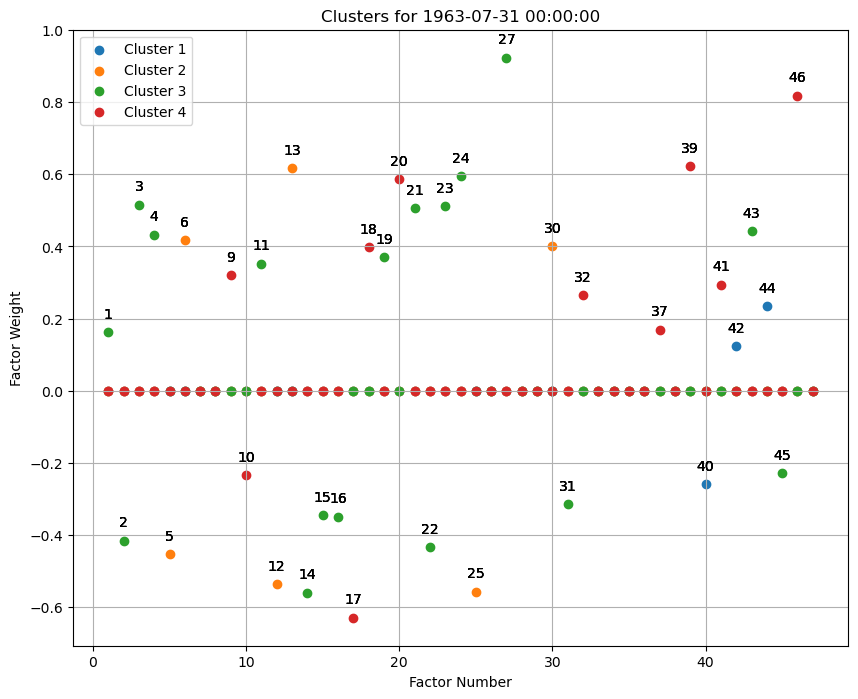

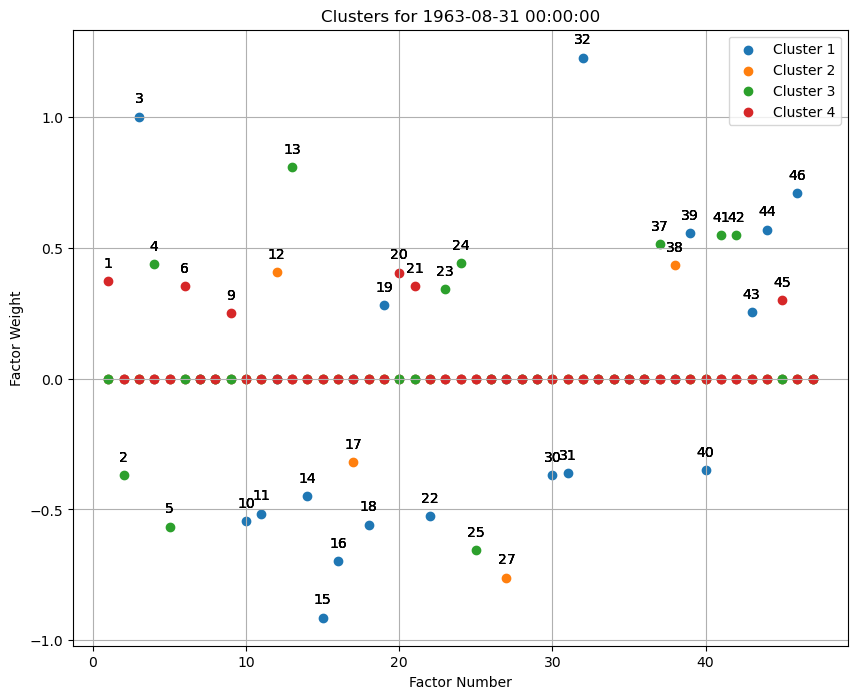

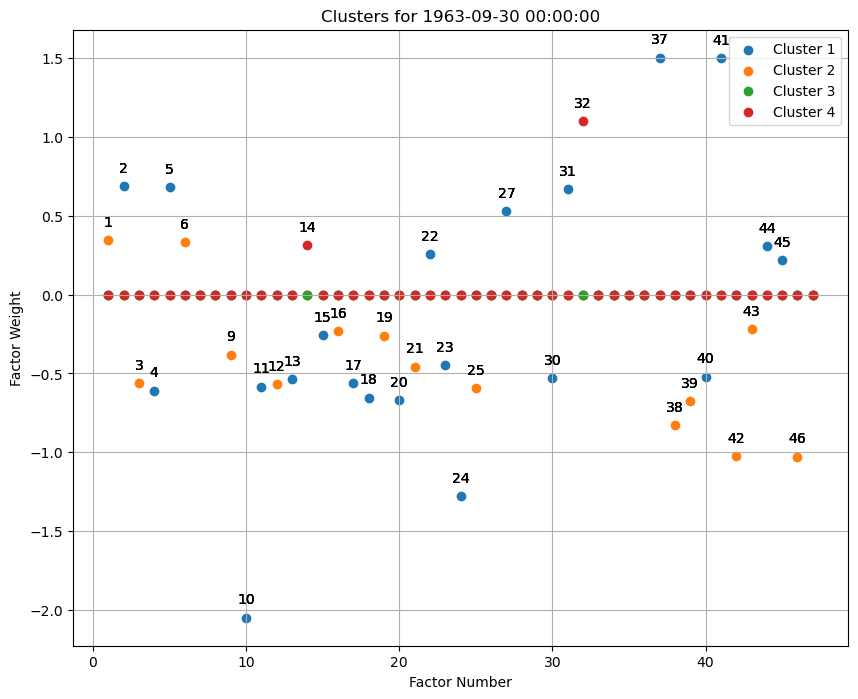

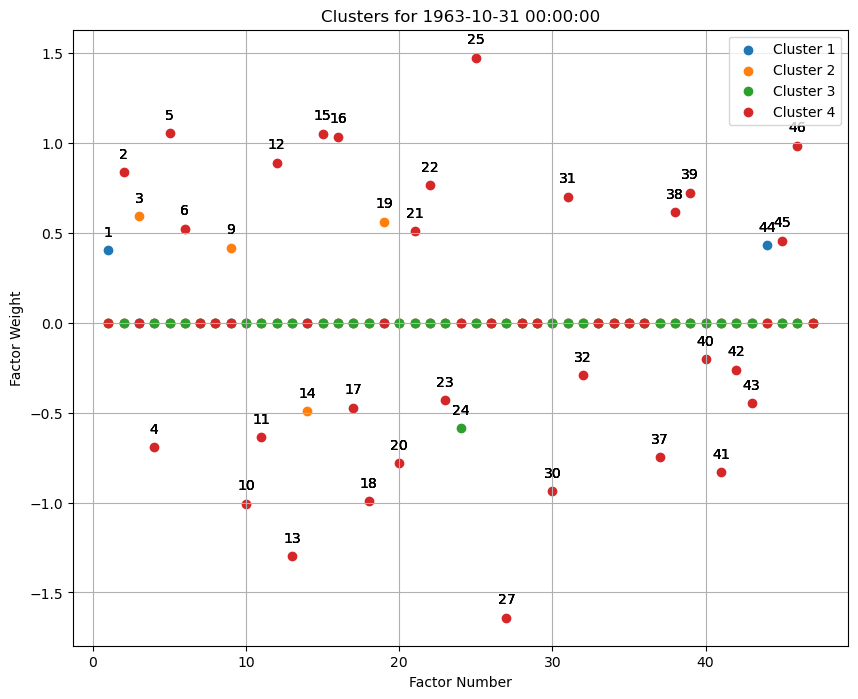

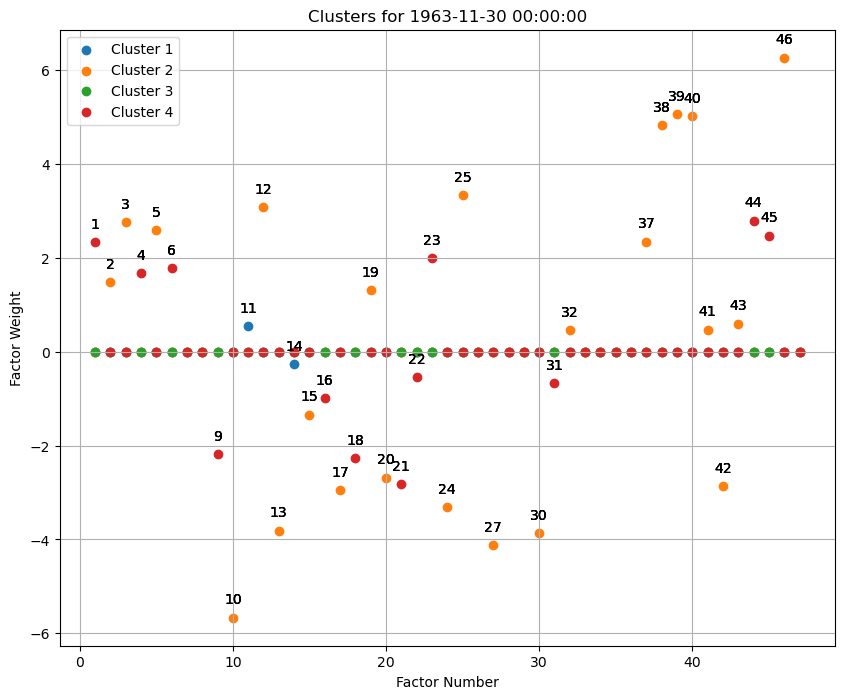

...

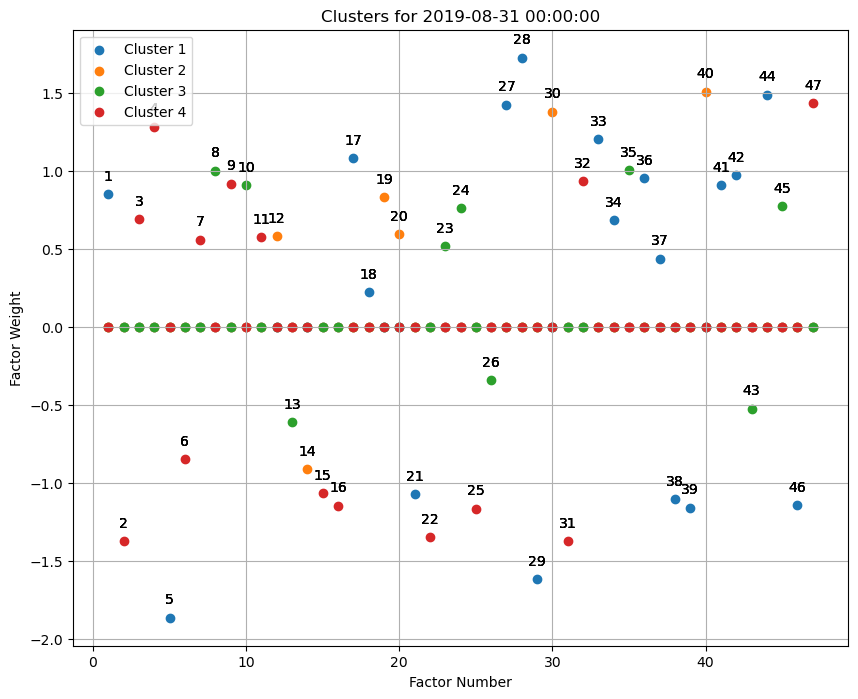

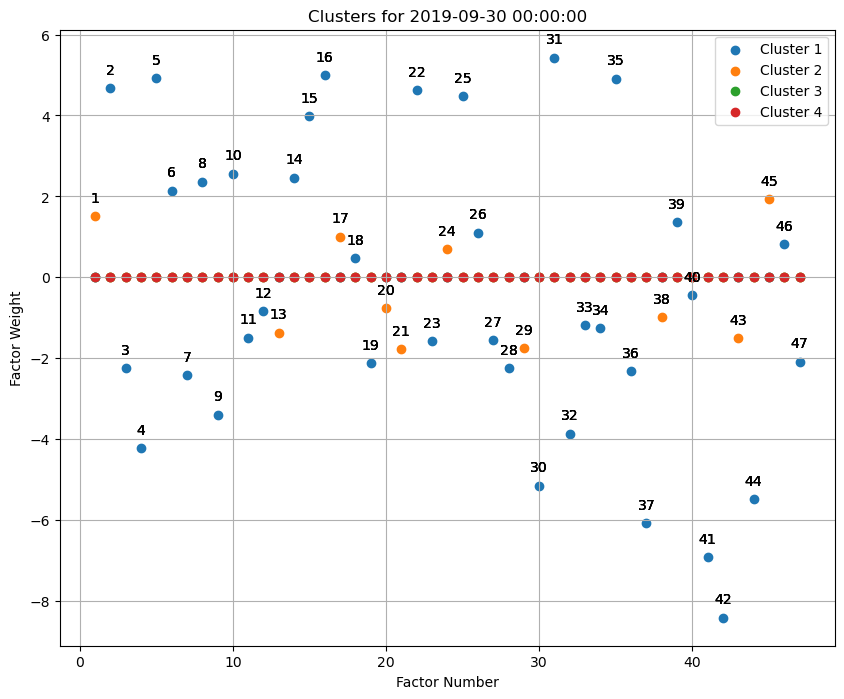

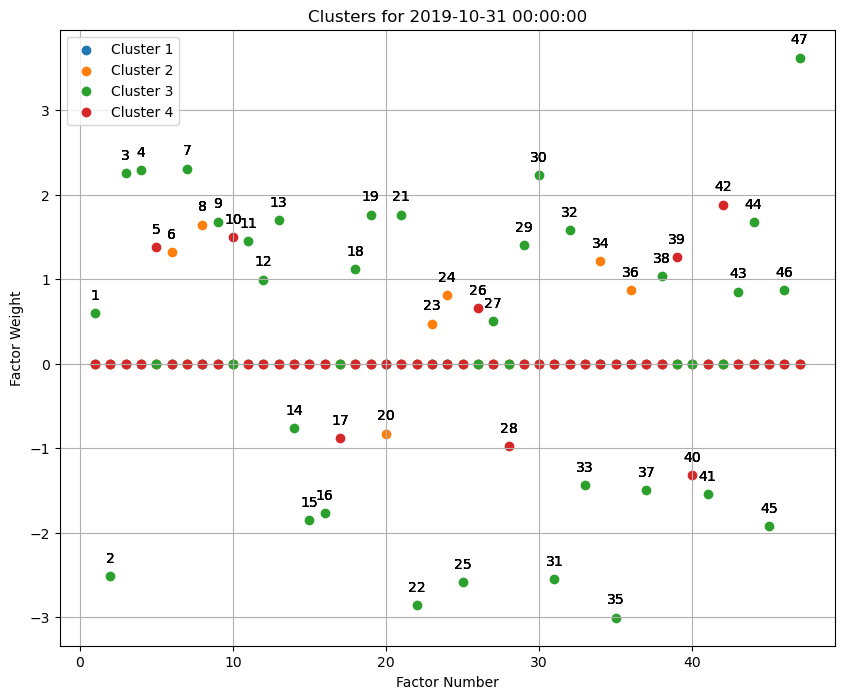

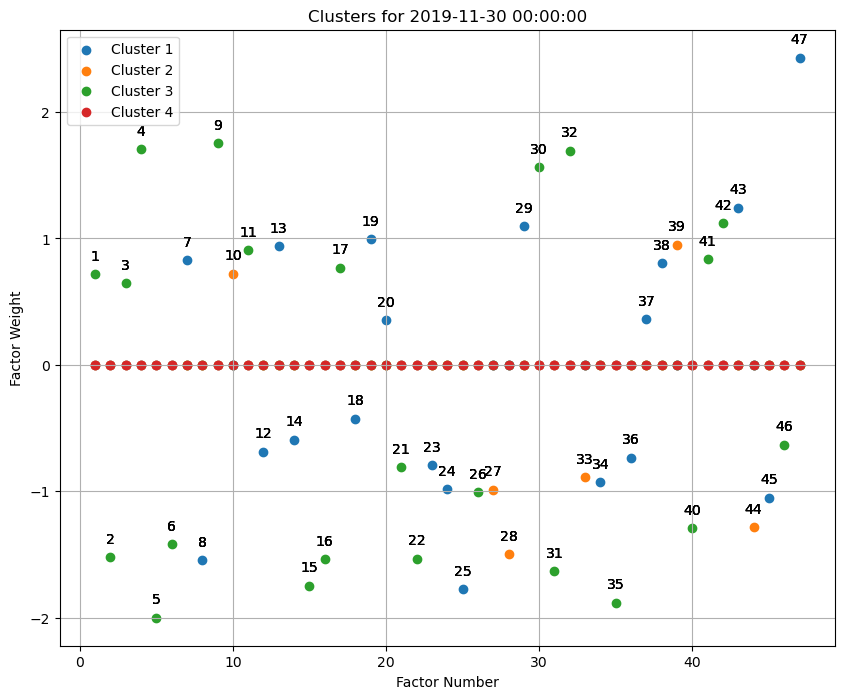

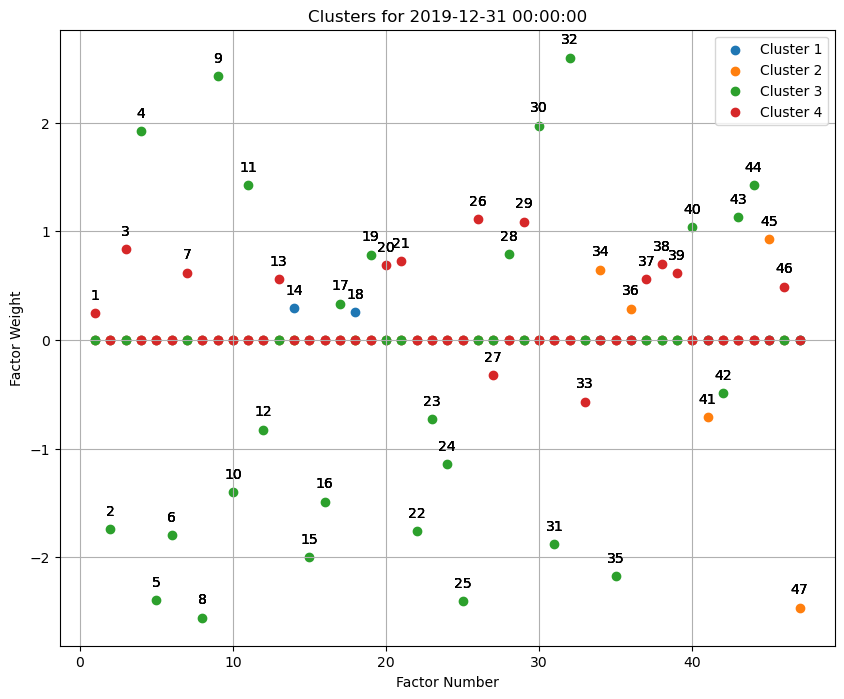

In [14]:
#Here clustering per month using the daily data which has not been interpolated

# Assuming optimal number of clusters is 4
num_clusters = 4  

# Define the threshold for disallowing weights close to 0 to be assigned to a cluster.
weight_threshold = 0.05

# Dictionary to store cluster assignments for each month
monthly_cluster_assignments = {}

# Iterate over each month in the DataFrame
for month, data in kmeans1.groupby(pd.Grouper(freq='M')):
    # Perform K-means clustering for the current month
    kmeans_model = KMeans(n_clusters=num_clusters, random_state=69)
    cluster_assignments = kmeans_model.fit_predict(data)
    
    # Store cluster assignments and centroids for the current month
    cluster_centers = kmeans_model.cluster_centers_
    
    # Filter factors with weights close to 0 for each cluster
    filtered_centers = []
    for centroid in cluster_centers:
        filtered_centroid = np.array([weight if abs(weight) > weight_threshold else 0 for weight in centroid])
        filtered_centers.append(filtered_centroid)
    filtered_centers = np.array(filtered_centers)
    
    monthly_cluster_assignments[month] = (cluster_assignments, filtered_centers)

# Create a list of factor numbers (indices)
factor_indices = list(range(1, len(data.columns) + 1))

# Visualize all clusters for each month
for month, (cluster_assignments, cluster_centers) in monthly_cluster_assignments.items():
    plt.figure(figsize=(5, 5))
    plt.title(f'Clusters for {month}')
    plt.xlabel('Factor Number')
    plt.ylabel('Factor Weight')
    
    # Initialize an array to store the maximum absolute weight for each factor
    max_abs_weights = np.zeros(len(factor_indices))
    
    # Initialize an array to store the cluster ID with maximum weight for each factor
    max_weight_cluster = np.zeros(len(factor_indices), dtype=int)
    
    # Determine the maximum absolute weight and corresponding cluster ID for each factor starting from 1
    for factor_index in range(len(factor_indices)):
        max_abs_weight = 0
        for cluster_id in range(num_clusters):
            weight = cluster_centers[cluster_id][factor_index]
            if abs(weight) > abs(max_abs_weight):
                max_abs_weight = weight
                max_weight_cluster[factor_index] = cluster_id + 1  
        max_abs_weights[factor_index] = max_abs_weight
    
    # Plot the factors with their maximum absolute weights
    for cluster_id in range(1, num_clusters + 1):
        cluster_weights = np.where(max_weight_cluster == cluster_id, max_abs_weights, 0)
        plt.scatter(factor_indices, cluster_weights, marker='o', label=f'Cluster {cluster_id}')
    
    # Annotate each point with its factor number
    for i, txt in enumerate(factor_indices):
        for cluster_id in range(1, num_clusters + 1):
            weight = max_abs_weights[i]
            if weight != 0:  # Exclude factors with weights below the threshold
                plt.annotate(txt, (factor_indices[i], weight), textcoords="offset points", xytext=(0,10), ha='center')
    
    plt.legend()
    plt.grid(True)
    plt.show()

By converting everything that is calculated within the clustering technique above into a string we get the following output:

In [16]:
def compute_monthly_cluster_factor_values(kmeans1, num_clusters=4, weight_threshold=0.05):
    # Dictionary to store cluster factor values for each month
    monthly_cluster_factor_values = {}

    # Iterate over each month in the DataFrame
    for month, (cluster_assignments, cluster_centers) in monthly_cluster_assignments.items():
        # Initialize a dictionary to store factor values for each cluster
        cluster_factor_values = {}

        # Initialize arrays to store factor indices and weights for each cluster
        factor_indices_list = [[] for _ in range(num_clusters)]
        factor_weights_list = [[] for _ in range(num_clusters)]

        # Determine the cluster with the maximum absolute weight for each factor
        max_weight_cluster = np.argmax(np.abs(cluster_centers), axis=0) + 1  
        max_abs_weights = np.max(np.abs(cluster_centers), axis=0)

        # Store factor values for each cluster
        for factor_index in range(len(factor_indices)):
            cluster_id = max_weight_cluster[factor_index]
            weight = cluster_centers[cluster_id - 1][factor_index]  
            if abs(weight) > weight_threshold:
                factor_indices_list[cluster_id - 1].append(factor_index + 1)  
                factor_weights_list[cluster_id - 1].append(weight)

        # Store cluster factor values for the current month
        for cluster_id in range(num_clusters):
            cluster_factor_values[cluster_id + 1] = {'factor_indices': factor_indices_list[cluster_id],
                                                     'factor_weights': factor_weights_list[cluster_id]}
        
        monthly_cluster_factor_values[month] = cluster_factor_values

    return monthly_cluster_factor_values

monthly_cluster_factor_weights = compute_monthly_cluster_factor_values(kmeans1)


print(monthly_cluster_factor_weights)

{Timestamp('1963-07-31 00:00:00'): {1: {'factor_indices': [40, 42, 44], 'factor_weights': [-0.2589933086389555, 0.12382480346363917, 0.23446115107716037]}, 2: {'factor_indices': [5, 6, 12, 13, 25, 30], 'factor_weights': [-0.4534656047615167, 0.4165795286884524, -0.5367119614251561, 0.6162543491682394, -0.5565973620136921, 0.40178511736202066]}, 3: {'factor_indices': [1, 2, 3, 4, 11, 14, 15, 16, 19, 21, 22, 23, 24, 27, 31, 43, 45], 'factor_weights': [0.16349687788442074, -0.4155418778226303, 0.5154311667307426, 0.43271425661221646, 0.3522809045581187, -0.5594985038124604, -0.3449540813040588, -0.34864590118804367, 0.3696612208035916, 0.5062456186920228, -0.432891827863855, 0.5107241597654045, 0.5946765402576295, 0.9229197087465469, -0.31368504561514265, 0.44332912560305787, -0.22848893256235808]}, 4: {'factor_indices': [9, 10, 17, 18, 20, 32, 37, 39, 41, 46], 'factor_weights': [0.32136212315294976, -0.23297771084354074, -0.628849985053061, 0.39761532491993457, 0.5858176223709493, 0.2642

In [72]:
#Scaling and demeaning the factor weights

def scale_and_demean_factors(monthly_cluster_factor_weights):
    # Dictionary to store scaled and demeaned factor values for each month
    scaled_demeaned_factors = {}

    # Compute mean and standard deviation for each factor
    factor_means = {}
    factor_stddevs = {}
    for month_factors in monthly_cluster_factor_weights.values():
        for cluster_factors in month_factors.values():
            for factor_index, factor_weight in zip(cluster_factors['factor_indices'], cluster_factors['factor_weights']):
                if factor_index not in factor_means:
                    factor_means[factor_index] = []
                    factor_stddevs[factor_index] = []
                factor_means[factor_index].append(factor_weight)
    
    for factor_index, values in factor_means.items():
        factor_means[factor_index] = np.mean(values)
        factor_stddevs[factor_index] = np.std(values)

    # Scale and demean factor values for each month
    for month, month_factors in monthly_cluster_factor_weights.items():
        scaled_demeaned_factors[month] = {}
        for cluster_id, cluster_factors in month_factors.items():
            scaled_demeaned_factors[month][cluster_id] = {}
            for factor_index, factor_weight in zip(cluster_factors['factor_indices'], cluster_factors['factor_weights']):
                scaled_weight = (factor_weight - factor_means[factor_index]) / factor_stddevs[factor_index]
                scaled_demeaned_factors[month][cluster_id][factor_index] = scaled_weight

    return scaled_demeaned_factors

# Call the function to scale and demean factor values
scaled_demeaned_factors = scale_and_demean_factors(monthly_cluster_factor_weights)

print(scaled_demeaned_factors)



{Timestamp('1963-07-31 00:00:00'): {1: {40: -0.1453111880830583, 42: 0.28541493309367855, 44: 0.19506149015996535}, 2: {5: -0.2696653101761611, 6: 0.14258873578087136, 12: -0.30578414066513676, 13: 0.47592014543646577, 25: -0.2511511949236899, 30: 0.23029381122185227}, 3: {1: -0.12011308665648343, 2: -0.19802422590235103, 3: 0.3812913114930068, 4: 0.2051197151875266, 11: 0.22165764575191144, 14: -0.36163166059850627, 15: -0.19609392715224883, 16: -0.1893133329401224, 19: 0.15439275955498052, 21: 0.3188068492154038, 22: -0.2320144728006949, 23: 0.32008002447112055, 24: 0.288834451752215, 27: 0.638136005807899, 31: -0.24461631493276098, 43: 0.30096758941485996, 45: -0.20622048513641167}, 4: {9: 0.16868082851961427, 10: -0.2400140656638178, 17: -0.380153134789924, 18: 0.2487593369036892, 20: 0.40819708644512614, 32: 0.1632327292666063, 37: 0.2830598007829535, 39: 0.2965143119150173, 41: 0.38330212701355537, 46: 0.4012857590651564}}, Timestamp('1963-08-31 00:00:00'): {1: {3: 0.670989231731

In [78]:
#Given that this output is non-useable in its current state we transform it to fit the average factor returns per month dataframe.

# Initialize an empty list to store data
data = []

# Iterate over each month and cluster
for date, clusters in scaled_demeaned_factors.items():
    for cluster, factors in clusters.items():
        # Iterate over each factor and weight
        for factor, weight in factors.items():
            data.append({'date': date, 'cluster': cluster, 'factor': factor, 'weight': weight})

scaled_demeaned_weights = pd.DataFrame(data)

#The new dataframe that can be used:
print(scaled_demeaned_weights)


            date  cluster  factor    weight
0     1963-07-31        1      40 -0.145311
1     1963-07-31        1      42  0.285415
2     1963-07-31        1      44  0.195061
3     1963-07-31        2       5 -0.269665
4     1963-07-31        2       6  0.142589
...          ...      ...     ...       ...
30757 2019-12-31        4      33 -0.258978
30758 2019-12-31        4      37  0.447205
30759 2019-12-31        4      38  0.378428
30760 2019-12-31        4      39  0.290492
30761 2019-12-31        4      46  0.234860

[30762 rows x 4 columns]


In [62]:
#calculating the original average return per factor

def calculate_average_return_per_factor(kmeans1):
    #Group data by month
    monthly_data = kmeans1.resample('M').mean()
    
    #Return average return per month per factor
    return monthly_data

average_returns_per_factor_per_month = calculate_average_return_per_factor(kmeans1)
print(average_returns_per_factor_per_month)


              r_size   r_value    r_prof     r_dur  r_valprof  r_fscore  \
date                                                                      
1963-07-31  0.126195 -0.060525 -0.050530  0.059954  -0.086836  0.183547   
1963-08-31  0.091812 -0.017057  0.167376  0.030979   0.124496  0.067419   
1963-09-30  0.041617  0.088491 -0.073724  0.015989   0.006385 -0.028174   
1963-10-31  0.058744  0.084312  0.214118  0.048482   0.255451  0.218704   
1963-11-30  0.189898  0.047979 -0.122839 -0.082128  -0.135852  0.057668   
...              ...       ...       ...       ...        ...       ...   
2019-08-31  0.304756 -0.408378  0.159872  0.338254  -0.546630 -0.034170   
2019-09-30  0.153517  0.687118 -0.393417 -0.649229   0.591501  0.573335   
2019-10-31  0.043221 -0.131769  0.235989  0.041191   0.266776  0.062182   
2019-11-30  0.029590 -0.332464  0.078482  0.456853  -0.244941 -0.297040   
2019-12-31  0.064401  0.215442 -0.125900 -0.217780   0.215897  0.211039   

            r_debtiss  r

In [110]:
#Given that the original columns for the average returns per factor per month still includes the factor names instead of the numbering used in calculating the clustering
#we rename them to fit those.

column_name_to_index = {
    'r_size': 1,
    'r_value': 2,
    'r_prof': 3,
    'r_dur': 4,
    'r_valprof': 5,
    'r_fscore': 6,
    'r_debtiss': 7,
    'r_repurch': 8,
    'r_nissa': 9,
    'r_accruals': 10,
    'r_growth': 11,
    'r_aturnover': 12,
    'r_gmargins': 13,
    'r_divp': 14,
    'r_ep': 15,
    'r_cfp': 16,
    'r_noa': 17,
    'r_inv': 18,
    'r_invcap': 19,
    'r_igrowth': 20,
    'r_sgrowth': 21,
    'r_lev': 22,
    'r_roaa': 23,
    'r_roea': 24,
    'r_sp': 25,
    'r_gltnoa': 26,
    'r_divg': 27,
    'r_invaci': 28,
    'r_shortint': 29,
    'r_lrrev': 30,
    'r_valuem': 31,
    'r_nissm': 32,
    'r_sue': 33,
    'r_roe': 34,
    'r_rome': 35,
    'r_roa': 36,
    'r_strev': 37,
    'r_ivol': 38,
    'r_betaarb': 39,
    'r_season': 40,
    'r_indrrev': 41,
    'r_indrrevlv': 42,
    'r_ciss': 43,
    'r_price': 44,
    'r_age': 45,
    'r_shvol': 46,
    'r_ipo': 47
}

# Rename columns using the updated mapping
average_returns_per_factor_per_month = average_returns_per_factor_per_month.rename(columns=column_name_to_index)

#Desired column names:
print(average_returns_per_factor_per_month)

                  1         2         3         4         5         6   \
date                                                                     
1963-07-31  0.126195 -0.060525 -0.050530  0.059954 -0.086836  0.183547   
1963-08-31  0.091812 -0.017057  0.167376  0.030979  0.124496  0.067419   
1963-09-30  0.041617  0.088491 -0.073724  0.015989  0.006385 -0.028174   
1963-10-31  0.058744  0.084312  0.214118  0.048482  0.255451  0.218704   
1963-11-30  0.189898  0.047979 -0.122839 -0.082128 -0.135852  0.057668   
...              ...       ...       ...       ...       ...       ...   
2019-08-31  0.304756 -0.408378  0.159872  0.338254 -0.546630 -0.034170   
2019-09-30  0.153517  0.687118 -0.393417 -0.649229  0.591501  0.573335   
2019-10-31  0.043221 -0.131769  0.235989  0.041191  0.266776  0.062182   
2019-11-30  0.029590 -0.332464  0.078482  0.456853 -0.244941 -0.297040   
2019-12-31  0.064401  0.215442 -0.125900 -0.217780  0.215897  0.211039   

                  7         8        

In [116]:
#Here we construct the first 10 year momentum strategy similar to what they did in the paper.
#However, we set the lookback period to 6 months.

def construct_momentum_strategy(scaled_demeaned_weights, average_returns_per_factor_per_month, lookback_months=6, rebalance_months=6, years=10):
    # Initialize dictionary to store the strategy
    momentum_strategy = {}

    # Every cluster
    for date, clusters in scaled_demeaned_weights.groupby('date'):
        if len(momentum_strategy) == 0 or (date - list(momentum_strategy.keys())[-1]).days >= rebalance_months * 10:
            # Rebalance the strategy every `rebalance_months`: 6 months
            
            # Initialize dictionary to store factor positions
            factor_positions = {}
            
            # Iterate through each cluster
            for cluster, factors in clusters.groupby('cluster'):
                long_factors = []
                short_factors = []
                
                # Iterate through factors and their weights in the cluster
                for factor, weight in zip(factors['factor'], factors['weight']):
                    # Multiply factor weight by average return for the month
                    factor_return = weight * average_returns_per_factor_per_month.loc[date, factor]
                    
                    # Determine long or short position based on sign of factor return
                    if factor_return > 0:
                        long_factors.append((factor, factor_return))
                    elif factor_return < 0:
                        short_factors.append((factor, factor_return))
                
                # Sort factors by their returns
                long_factors.sort(key=lambda x: x[1], reverse=True)
                short_factors.sort(key=lambda x: x[1])
                
                # Take the top `lookback_months`:6 factors for long and short positions
                long_factors = long_factors[:lookback_months]
                short_factors = short_factors[:lookback_months]
                
                # Store long and short positions for the cluster
                factor_positions[cluster] = {'long': long_factors, 'short': short_factors}
            
            # Store the factor positions for the current month
            momentum_strategy[date] = factor_positions

        # Stop after 10 of data
            if (date - list(momentum_strategy.keys())[0]).days >= 365.25 * years:
                break

    return momentum_strategy

momentum_strategy = construct_momentum_strategy(scaled_demeaned_weights, average_returns_per_factor_per_month)

# Print the strategy
for date, factors in momentum_strategy.items():
    print(f"For {date}:")
    for cluster, positions in factors.items():
        print(f"Cluster {cluster}:")
        print(f"\tLong positions: {positions['long']}")
        print(f"\tShort positions: {positions['short']}")


For 1963-07-31 00:00:00:
Cluster 1:
	Long positions: [(42, 0.03534144799591247), (44, 0.03243236121257805), (40, 0.006223687039453898)]
	Short positions: []
Cluster 2:
	Long positions: [(13, 0.11619152186770537), (25, 0.047477482763950196), (12, 0.04518827903750046), (6, 0.026171720642587385), (30, 0.02613307659470805), (5, 0.023416660052438216)]
	Short positions: []
Cluster 3:
	Long positions: [(14, 0.04489835573530593), (27, 0.039999736320574915), (24, 0.03198407477959558), (23, 0.027107906259207233), (21, 0.025346997669618784), (31, 0.014820910402437588)]
	Short positions: [(3, -0.019266473731517315), (45, -0.01799467565070104), (1, -0.015157718326392181), (11, -0.009398539282919284)]
Cluster 4:
	Long positions: [(10, 0.01250247327574296), (18, 0.008941488179664817), (37, 0.0064917648943833926), (41, 0.005848392284082248)]
	Short positions: [(46, -0.03654200787768468), (17, -0.03141500833995076), (39, -0.02576680374707768), (32, -0.007428932642402033), (20, -0.0005607131212925294), 